In [25]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.cm as cm

import seaborn as sns
from sklearn.preprocessing import StandardScaler

from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
from sklearn import metrics

In [26]:
df=pd.read_csv('/Users/da_learner_mac_45/Downloads/station_weather_data.csv')
df.head(5)

,STATION,NAME,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,PRCP_ATTRIBUTES,TAVG,TAVG_ATTRIBUTES,TMAX,TMAX_ATTRIBUTES,TMIN,TMIN_ATTRIBUTES
0,SF001447910,"NOUPOORT, SF",-31.183,24.95,1496.0,2022-07-01,NaN,NaN,8.8,"H,,S",16.0,",,S",-1.7,",,S"
1,SF001447910,"NOUPOORT, SF",-31.183,24.95,1496.0,2022-07-02,NaN,NaN,11.1,"H,,S",17.4,",,S",3.5,",,S"
2,SF001447910,"NOUPOORT, SF",-31.183,24.95,1496.0,2022-07-03,NaN,NaN,11.6,"H,,S",18.3,",,S",6.8,",,S"
3,SF001447910,"NOUPOORT, SF",-31.183,24.95,1496.0,2022-07-04,NaN,NaN,9.3,"H,,S",19.0,",,S",0.8,",,S"
4,SF001447910,"NOUPOORT, SF",-31.183,24.95,1496.0,2022-07-05,NaN,NaN,10.4,"H,,S",19.0,",,S",7.3,",,S"


In [27]:
df.dtypes

STATION             object
NAME                object
LATITUDE           float64
LONGITUDE          float64
ELEVATION          float64
DATE                object
PRCP               float64
PRCP_ATTRIBUTES     object
TAVG               float64
TAVG_ATTRIBUTES     object
TMAX               float64
TMAX_ATTRIBUTES     object
TMIN               float64
TMIN_ATTRIBUTES     object
dtype: object

In [28]:
df.shape

(12444, 14)

In [29]:
df.isnull().sum()

STATION               0
NAME                  0
LATITUDE              0
LONGITUDE             0
ELEVATION             0
DATE                  0
PRCP               8571
PRCP_ATTRIBUTES    8571
TAVG                  0
TAVG_ATTRIBUTES       0
TMAX                816
TMAX_ATTRIBUTES     816
TMIN                934
TMIN_ATTRIBUTES     934
dtype: int64

In [30]:
df=df.dropna()

In [31]:
df.isnull().sum()

STATION            0
NAME               0
LATITUDE           0
LONGITUDE          0
ELEVATION          0
DATE               0
PRCP               0
PRCP_ATTRIBUTES    0
TAVG               0
TAVG_ATTRIBUTES    0
TMAX               0
TMAX_ATTRIBUTES    0
TMIN               0
TMIN_ATTRIBUTES    0
dtype: int64

In [32]:
df.columns

Index(['STATION', 'NAME', 'LATITUDE', 'LONGITUDE', 'ELEVATION', 'DATE', 'PRCP',
       'PRCP_ATTRIBUTES', 'TAVG', 'TAVG_ATTRIBUTES', 'TMAX', 'TMAX_ATTRIBUTES',
       'TMIN', 'TMIN_ATTRIBUTES'],
      dtype='object')

In [33]:
pip install mplcyberpunk

Note: you may need to restart the kernel to use updated packages.


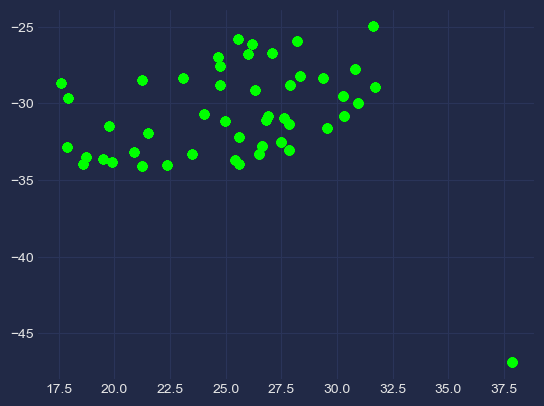

In [34]:
import mplcyberpunk

plt.style.use('cyberpunk')

plt.scatter(df['LONGITUDE'],df['LATITUDE'],marker='o',c='lime')

In [35]:
# Calculate the Z-scores for each value in the longitude and latitude columns
z_scores_longitude = np.abs((df['LONGITUDE'] - df['LONGITUDE'].mean()) / df['LONGITUDE'].std())
z_scores_latitude = np.abs((df['LATITUDE'] - df['LATITUDE'].mean()) / df['LATITUDE'].std())

# Define a threshold value for the Z-score
threshold = 3

# Identify the outlier indices where the Z-score is greater than the threshold
outlier_indices = np.union1d(np.where(z_scores_longitude > threshold)[0], np.where(z_scores_latitude > threshold)[0])

# Print the number of outliers and their indices
print(f"Number of outliers: {len(outlier_indices)}")
print(f"Outlier indices: {outlier_indices}")


Number of outliers: 233
Outlier indices: [1959 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972
 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986
 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000
 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014
 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024 2025 2026 2027 2028
 2029 2030 2031 2032 2033 2034 2035 2036 2037 2038 2039 2040 2041 2042
 2043 2044 2045 2046 2047 2048 2049 2050 2051 2052 2053 2054 2055 2056
 2057 2058 2059 2060 2061 2062 2063 2064 2065 2066 2067 2068 2069 2070
 2071 2072 2073 2074 2075 2076 2077 2078 2079 2080 2081 2082 2083 2084
 2085 2086 2087 2088 2089 2090 2091 2092 2093 2094 2095 2096 2097 2098
 2099 2100 2101 2102 2103 2104 2105 2106 2107 2108 2109 2110 2111 2112
 2113 2114 2115 2116 2117 2118 2119 2120 2121 2122 2123 2124 2125 2126
 2127 2128 2129 2130 2131 2132 2133 2134 2135 2136 2137 2138 2139 2140
 2141 2142 2143 2144 2145 2146 2147 

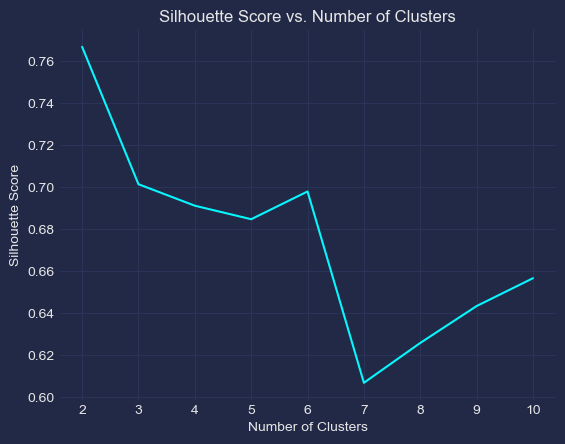

In [36]:
from sklearn.metrics import silhouette_score

# Select only numeric columns and drop the rest
numeric_cols = df.select_dtypes(include='number').columns
df_numeric = df[numeric_cols]

# Calculate the Silhouette score for each number of clusters
sil_scores = []
clusters = range(2, 11)
for n_clusters in clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=None)
    cluster_labels = kmeans.fit_predict(df_numeric)
    sil_score = silhouette_score(df_numeric, cluster_labels)
    sil_scores.append(sil_score)

# Plot the Silhouette scores
plt.plot(clusters, sil_scores)
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters')
plt.show()

**The optimal number of cluster is 9**



In [37]:
km=KMeans(n_clusters=9)
xfeatures=df[['LONGITUDE','LATITUDE']]

In [38]:
import warnings
warnings.filterwarnings('ignore')

clusters=km.fit_predict(xfeatures)
clusters
# import warnings
# warnings.filterwarnings('ignore')display(clusters)

array([7, 7, 7, ..., 5, 5, 5], dtype=int32)

In [39]:
import warnings
warnings.filterwarnings('ignore')

km.fit(xfeatures)
km.labels_

array([0, 0, 0, ..., 4, 4, 4], dtype=int32)

In [40]:
clusters in km.labels_

False

In [41]:
km.cluster_centers_

array([[ 25.95750633, -32.90102321],
       [ 37.867     , -46.883     ],
       [ 30.50043947, -30.14935158],
       [ 24.4310339 , -28.56221186],
       [ 18.78906944, -32.61923333],
       [ 26.87699625, -26.20455431],
       [ 27.59810339, -32.04801454],
       [ 21.90822176, -33.53483682],
       [ 29.41972149, -27.93108223]])

In [42]:
df['clusters_province']=clusters

In [43]:
df.tail(6)

,STATION,NAME,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,PRCP_ATTRIBUTES,TAVG,TAVG_ATTRIBUTES,TMAX,TMAX_ATTRIBUTES,TMIN,TMIN_ATTRIBUTES,clusters_province
12418,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-11,0.8,",,S",17.3,"H,,S",22.0,",,S",14.4,",,S",5
12419,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-12,0.3,",,S",15.2,"H,,S",22.0,",,S",12.0,",,S",5
12420,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-13,0.0,",,S",15.7,"H,,S",19.7,",,S",12.8,",,S",5
12425,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-25,0.5,",,S",17.6,"H,,S",20.7,",,S",16.7,",,S",5
12426,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-26,0.8,",,S",18.0,"H,,S",21.8,",,S",14.9,",,S",5
12427,SF000068712,"CAPE COLUMBINE, SF",-32.833,17.85,67.0,2023-03-27,0.0,",,S",19.6,"H,,S",28.7,",,S",14.1,",,S",5


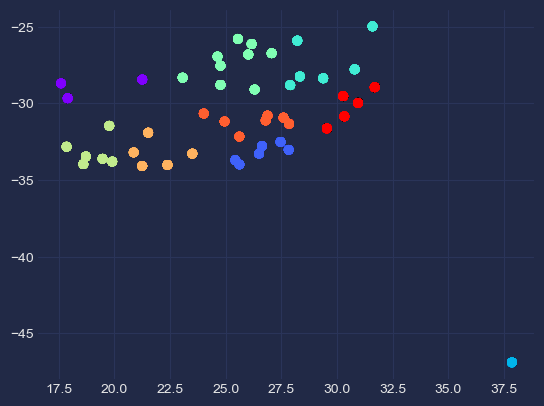

In [44]:
plt.style.use('cyberpunk')
plt.scatter(df['LONGITUDE'],df['LATITUDE'],c=df['clusters_province'],cmap='rainbow')

In [45]:
import folium
from folium.plugins import MarkerCluster

# Define the map center and zoom level
center = [df['LATITUDE'].mean(), df['LONGITUDE'].mean()]
zoom = 5

# Create a dictionary to map cluster numbers to colors
color_map = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'purple',
    4: 'orange',
    5: 'darkred',
    6: 'darkblue',
    7: 'darkgreen',
    8: 'gray',
}

# Create the map
m = folium.Map(location=center, zoom_start=zoom)

# Create a MarkerCluster layer
marker_cluster = MarkerCluster().add_to(m)

# Add the points layer to the MarkerCluster layer
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=5,
        color=None,
        fill=True,
        fill_color=color_map[row['clusters_province']],
        fill_opacity=1
    ).add_to(marker_cluster)
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        icon=None,
        popup=row['NAME'],
    ).add_to(marker_cluster)

# Display the map
m


In [46]:
import folium
from folium.plugins import MarkerCluster

# Define the map center and zoom level
center = [df['LATITUDE'].mean(), df['LONGITUDE'].mean()]
zoom = 5

# Create a dictionary to map cluster numbers to colors
color_map = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'purple',
    4: 'orange',
    5: 'darkred',
    6: 'darkblue',
    7: 'darkgreen',
    8: 'gray',
}

# Create the map
m = folium.Map(location=center, zoom_start=zoom)

# Create a MarkerCluster layer
marker_cluster = MarkerCluster().add_to(m)

# Add the points layer to the MarkerCluster layer
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=5,
        color=None,
        fill=True,
        fill_color=color_map[row['clusters_province']],
        fill_opacity=1,
        tooltip=row['NAME']  # Add tooltip with station name
    ).add_to(marker_cluster)
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        icon=None,
        popup=row['NAME'],
        tooltip=row['NAME']  # Add tooltip with station name
    ).add_to(marker_cluster)

# Display the map
m


In [47]:
import folium

# Define the map center and zoom level
center = [df['LATITUDE'].mean(), df['LONGITUDE'].mean()]
zoom = 5

# Create a dictionary to map cluster numbers to colors
color_map = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'purple',
    4: 'orange',
    5: 'darkred',
    6: 'darkblue',
    7: 'darkgreen',
    8: 'gray',
}

# Create the map
m = folium.Map(location=center, zoom_start=zoom)

# Add the points layer to the map
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=5,
        color=None,
        fill=True,
        fill_color=color_map[row['clusters_province']],
        fill_opacity=1
    ).add_to(m)
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        icon=None,
        popup=row['NAME'],
    ).add_to(m)

# Display the map
m
